<a href="https://colab.research.google.com/github/ritumunshi/cadenza_challenge/blob/main/Demucs_Open_Unmix_Normalized_Model.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install musdb
!pip install youtube-dl
!pip install openunmix

In [ ]:
import torch
import torchaudio
import numpy as np
import scipy
import youtube_dl
import stempeg
import os
from IPython.display import Audio, display

use_cuda = torch.cuda.is_available()
device = torch.device("cuda" if use_cuda else "cpu")

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')


In [ ]:
!pip install wavio


In [ ]:
output_dir = "C:\\Users\\ritum\\OneDrive\\Desktop\\AudioFolder-OpenUnmix" # Replace with your desired folder
#output_path = os.path.join(output_dir, f"{target}.wav")


In [ ]:
pip install numpy

In [ ]:
# We download the audio file from our storage. Feel free to download another file and use audio from a specific path
from torchaudio.pipelines import HDEMUCS_HIGH_MUSDB_PLUS
from torchaudio.utils import download_asset
SAMPLE_SONG = download_asset("tutorial-assets/hdemucs_mix.wav")
waveform, sample_rate = torchaudio.load(SAMPLE_SONG)  # replace SAMPLE_SONG with desired path for different song
#waveform = waveform.to(device)
#mixture = waveform


In [ ]:
import soundfile as sf
from openunmix import predict
import wavio
import numpy as np
from scipy.io.wavfile import write
import torchaudio

target_path = str("/content/sample_data/signal3.wav")
# Load the audio file
#track_audio, track_rate = sf.read(target_path)
#track_audio, track_rate = mixture
track_audio, track_rate = torchaudio.load(SAMPLE_SONG)

estimates = predict.separate(
    torch.as_tensor(track_audio).float(),
    rate=track_rate,
    targets=['vocals', 'drums', 'bass', 'other'],
    residual=True,
    device=device,
)





In [ ]:
for target, estimate in estimates.items():
    print(target)
    display(Audio(estimate.detach().cpu().numpy()[0], rate=track_rate))
    audio_data = estimate.detach().cpu().numpy()[0]

    output_path = os.path.join(output_dir, f"open_unmix_source_{target}.wav")

    # Normalize the audio data
    audio_data_normalized = (audio_data / np.max(np.abs(audio_data)) * 32767).astype(np.int16)

    # Write the file
    write(output_path, track_rate, audio_data_normalized.T) # Transpose if the data is stereo

    print(f"{target} written to {output_path}")

In [ ]:
pip install mir_eval

Note: you may need to restart the kernel to use updated packages.


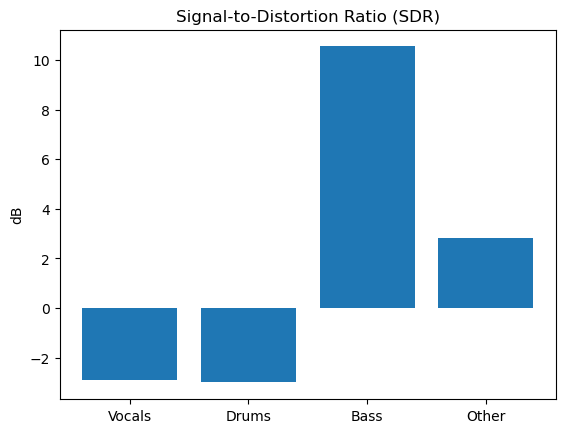

Vocals: -2.90 dB
Drums: -3.00 dB
Bass: 10.54 dB
Other: 2.83 dB


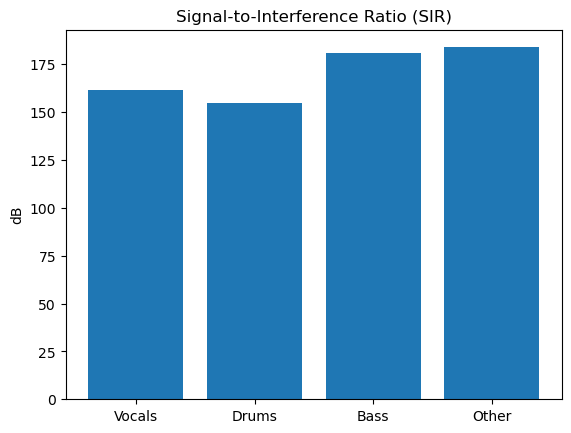

Vocals: 161.41 dB
Drums: 154.59 dB
Bass: 180.85 dB
Other: 183.80 dB


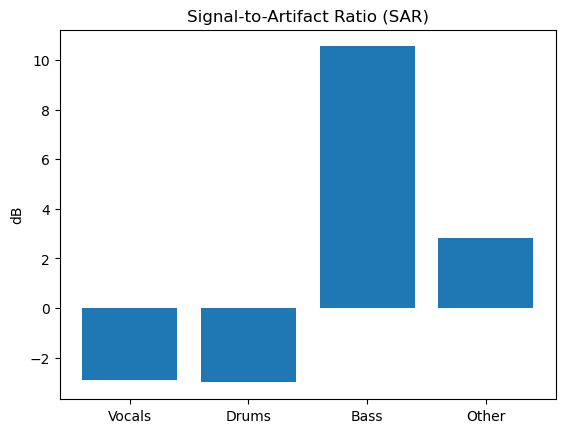

Vocals: -2.90 dB
Drums: -3.00 dB
Bass: 10.54 dB
Other: 2.83 dB


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import torchaudio
from mir_eval.separation import bss_eval_sources

# Function to plot a bar graph for a given metric
def plot_metric(metric_values, title):
    plt.bar(labels, metric_values)
    plt.ylabel('dB')
    plt.title(title)
    plt.show()
    for label, value in zip(labels, metric_values):
        print(f"{label}: {value:.2f} dB")


# Sample path to the original mixture (replace with the actual path)
#SAMPLE_SONG = "path_to_original_mixture.wav"

# Load the original and separated stems
original_stems = []
separated_stems = []

for target in ['vocals', 'drums', 'bass', 'other']: #,'residual']:
    # Assuming the original mixture is used for all stems (replace with actual original stems if available)
    original_waveform, _ = torchaudio.load(SAMPLE_SONG)

    # Replace with the correct paths to your separated stems
    separated_path = f"C:\\Users\\ritum\\OneDrive\\Desktop\\AudioFolder-OpenUnmix\\open_unmix_source_{target}.wav"

    separated_waveform, _ = torchaudio.load(separated_path)

    # Convert to mono if stereo
    original_mono = original_waveform.mean(dim=0)
    separated_mono = separated_waveform.mean(dim=0)

    original_stems.append(original_mono.numpy())
    separated_stems.append(separated_mono.numpy())

# Stack the stems into arrays with shape (4, n_samples)
original_stems = np.stack(original_stems)
separated_stems = np.stack(separated_stems)

# Calculate SDR, SIR, and SAR
sdr, sir, sar, _ = bss_eval_sources(original_stems, separated_stems)

# Labels for the stems
labels = ['Vocals', 'Drums', 'Bass', 'Other']

# Plot SDR
plot_metric(sdr, 'Signal-to-Distortion Ratio (SDR)')

# Plot SIR
plot_metric(sir, 'Signal-to-Interference Ratio (SIR)')

# Plot SAR
plot_metric(sar, 'Signal-to-Artifact Ratio (SAR)')


In [ ]:
pip install --upgrade librosa numba


     -------------------------------------- 253.0/253.0 kB 3.9 MB/s eta 0:00:00
     ---------------------------------------- 2.5/2.5 MB 11.5 MB/s eta 0:00:00
     ---------------------------------------- 14.8/14.8 MB 9.9 MB/s eta 0:00:00
     ---------------------------------------- 27.7/27.7 MB 9.0 MB/s eta 0:00:00
  Attempting uninstall: numpy
    Found existing installation: numpy 1.25.2
    Uninstalling numpy-1.25.2:
      Successfully uninstalled numpy-1.25.2
Note: you may need to restart the kernel to use updated packages.


ERROR: Could not install packages due to an OSError: [WinError 5] Access is denied: 'C:\\Users\\ritum\\anaconda3\\Lib\\site-packages\\~=mpy\\.libs\\libopenblas64__v0.3.23-246-g3d31191b-gcc_10_3_0.dll'
Consider using the `--user` option or check the permissions.



In [ ]:
import librosa
from stoi import stoi
from pesq import pesq

#ref_file_path = 'path/to/reference_audio.wav'
#deg_file_path = 'path/to/degraded_audio.wav'

# Load the audio files
#ref, _ = librosa.load(ref_file_path, sr=rate)
#deg, _ = librosa.load(deg_file_path, sr=rate)


# Sample rate
rate = 16000

# File path for the reference signal
reference_file = SAMPLE_SONG #'path/to/reference.wav'


# File paths for the degraded signals (stems)
degraded_files = ['C:\\Users\\ritum\\OneDrive\\Desktop\\AudioFolder-OpenUnmix\\open_unmix_source_vocals.wav',
                  'C:\\Users\\ritum\\OneDrive\\Desktop\\AudioFolder-OpenUnmix\\open_unmix_source_bass.wav',
                  'C:\\Users\\ritum\\OneDrive\\Desktop\\AudioFolder-OpenUnmix\\open_unmix_source_other.wav',
                  'C:\\Users\\ritum\\OneDrive\\Desktop\\AudioFolder-OpenUnmix\\open_unmix_source_drums.wav']
                 #'C:\\Users\\ritum\\OneDrive\\Desktop\\AudioFolder-OpenUnmix\\open_unmix_source_residual.wav']

# Load the reference audio file
ref, _ = SAMPLE_SONG # librosa.load(reference_file, sr=rate)

# Loop through each degraded file
for deg_file in degraded_files:
    # Load the degraded audio file
    deg, _ = librosa.load(deg_file, sr=rate)

    # Calculate PESQ score
    score = pesq(rate, ref, deg, 'wb')
    print(f'PESQ score for {reference_file} and {deg_file}: {score}')

    # Calculate STOI score
    score = stoi(ref, deg, 16000, extended=False)
    print(f'STOI score: {score}')




In [ ]:
pip install demucs

In [ ]:
!pip install -U demucs

In [ ]:
from demucs import pretrained

from scipy.io.wavfile import write
import numpy as np
import os


In [ ]:
# Customize the following options!
model = "htdemucs"
extensions = ["mp3", "wav", "ogg", "flac"]  # we will look for all those file types.
two_stems = "vocals"   # only separate one stems from the rest, for instance
# two_stems = "vocals"

# Options for the output audio.
mp3 = True
mp3_rate = 320
wav = True
wav_rate = 320
float32 = False  # output as float 32 wavs, unsused if 'mp3' is True.
int24 = False    # output as int24 wavs, unused if 'mp3' is True.
# You cannot set both `float32 = True` and `int24 = True` !!

In [ ]:
!python -m demucs.separate --help


Traceback (most recent call last):
  File "/usr/lib/python3.10/runpy.py", line 196, in _run_module_as_main
    return _run_code(code, main_globals, None,
  File "/usr/lib/python3.10/runpy.py", line 86, in _run_code
    exec(code, run_globals)
  File "/usr/local/lib/python3.10/dist-packages/demucs/separate.py", line 17, in <module>
    from .audio import AudioFile, convert_audio, save_audio
  File "/usr/local/lib/python3.10/dist-packages/demucs/audio.py", line 10, in <module>
    import lameenc
ImportError: /usr/local/lib/python3.10/dist-packages/lameenc.cpython-310-x86_64-linux-gnu.so: undefined symbol: __pow_finite


In [ ]:
!python3 -m pip install -U git+https://github.com/facebookresearch/demucs#egg=demucs

Python was not found; run without arguments to install from the Microsoft Store, or disable this shortcut from Settings > Manage App Execution Aliases.


In [ ]:
!pip install asteroid


ERROR: Could not find a version that satisfies the requirement convtasnet (from versions: none)
ERROR: No matching distribution found for convtasnet


ERROR: Could not find a version that satisfies the requirement pretrained (from versions: none)
ERROR: No matching distribution found for pretrained


In [ ]:
import torch
import torchaudio

print(torch.__version__)
print(torchaudio.__version__)

import matplotlib.pyplot as plt

2.0.1+cpu
2.0.2+cpu


In [ ]:
pip install mir_eval


In [ ]:
from IPython.display import Audio
from mir_eval import separation
from torchaudio.pipelines import HDEMUCS_HIGH_MUSDB_PLUS
from torchaudio.utils import download_asset

In [ ]:
bundle = HDEMUCS_HIGH_MUSDB_PLUS

model = bundle.get_model()

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

model.to(device)

sample_rate = bundle.sample_rate

print(f"Sample rate: {sample_rate}")

Sample rate: 44100


In [ ]:
from torchaudio.transforms import Fade


def separate_sources(
    model,
    mix,
    segment=10.0,
    overlap=0.1,
    device=None,
):
    """
    Apply model to a given mixture. Use fade, and add segments together in order to add model segment by segment.

    Args:
        segment (int): segment length in seconds
        device (torch.device, str, or None): if provided, device on which to
            execute the computation, otherwise `mix.device` is assumed.
            When `device` is different from `mix.device`, only local computations will
            be on `device`, while the entire tracks will be stored on `mix.device`.
    """
    if device is None:
        device = mix.device
    else:
        device = torch.device(device)

    batch, channels, length = mix.shape

    chunk_len = int(sample_rate * segment * (1 + overlap))
    start = 0
    end = chunk_len
    overlap_frames = overlap * sample_rate
    fade = Fade(fade_in_len=0, fade_out_len=int(overlap_frames), fade_shape="linear")

    final = torch.zeros(batch, len(model.sources), channels, length, device=device)

    while start < length - overlap_frames:
        chunk = mix[:, :, start:end]
        with torch.no_grad():
            out = model.forward(chunk)
        out = fade(out)
        final[:, :, :, start:end] += out
        if start == 0:
            fade.fade_in_len = int(overlap_frames)
            start += int(chunk_len - overlap_frames)
        else:
            start += chunk_len
        end += chunk_len
        if end >= length:
            fade.fade_out_len = 0
    return final


def plot_spectrogram(stft, title="Spectrogram"):
    magnitude = stft.abs()
    spectrogram = 20 * torch.log10(magnitude + 1e-8).numpy()
    _, axis = plt.subplots(1, 1)
    axis.imshow(spectrogram, cmap="viridis", vmin=-60, vmax=0, origin="lower", aspect="auto")
    axis.set_title(title)
    plt.tight_layout()

In [ ]:
# Load the audio file
waveform, sample_rate =  torchaudio.load(SAMPLE_SONG)  #torchaudio.load("/content/sample_data/signal3.wav")
waveform = waveform.to(device)
mixture = waveform

# If the waveform is mono and the model expects stereo, repeat the channel
if waveform.shape[0] == 1 and model.audio_channels == 2:
    waveform = waveform.repeat(2, 1)  # Repeat the mono channel to create a stereo signal

# Parameters
segment: int = 10
overlap = 0.1

print("Separating track")

ref = waveform.mean(0)
waveform = (waveform - ref.mean()) / ref.std()  # Normalization

print(type(model))  # Check the type of the model variable
print(model)        # Print the value of the model variable
#model = load_model('htdemucs')


sources = separate_sources(
    model,
    waveform[None],
    device=device,
    segment=segment,
    overlap=overlap,
)[0]
sources = sources * ref.std() + ref.mean()

sources_list = model.sources
sources = list(sources)

audios = dict(zip(sources_list, sources))


Separating track
<class 'torchaudio.models._hdemucs.HDemucs'>
HDemucs(
  (freq_encoder): ModuleList(
    (0): _HEncLayer(
      (conv): Conv2d(4, 48, kernel_size=(8, 1), stride=(4, 1), padding=(2, 0))
      (norm1): Identity()
      (rewrite): Conv2d(48, 96, kernel_size=(1, 1), stride=(1, 1))
      (norm2): Identity()
      (dconv): _DConv(
        (layers): ModuleList(
          (0): Sequential(
            (0): Conv1d(48, 12, kernel_size=(3,), stride=(1,), padding=(1,))
            (1): GroupNorm(1, 12, eps=1e-05, affine=True)
            (2): GELU(approximate='none')
            (3): Conv1d(12, 96, kernel_size=(1,), stride=(1,))
            (4): GroupNorm(1, 96, eps=1e-05, affine=True)
            (5): GLU(dim=1)
            (6): _LayerScale()
          )
          (1): Sequential(
            (0): Conv1d(48, 12, kernel_size=(3,), stride=(1,), padding=(2,), dilation=(2,))
            (1): GroupNorm(1, 12, eps=1e-05, affine=True)
            (2): GELU(approximate='none')
            

In [ ]:
N_FFT = 4096
N_HOP = 4
stft = torchaudio.transforms.Spectrogram(
    n_fft=N_FFT,
    hop_length=N_HOP,
    power=None,
)

In [ ]:
from torchaudio.transforms import Fade


def separate_sources(
    model,
    mix,
    segment=10.0,
    overlap=0.1,
    device=None,
):
    """
    Apply model to a given mixture. Use fade, and add segments together in order to add model segment by segment.

    Args:
        segment (int): segment length in seconds
        device (torch.device, str, or None): if provided, device on which to
            execute the computation, otherwise `mix.device` is assumed.
            When `device` is different from `mix.device`, only local computations will
            be on `device`, while the entire tracks will be stored on `mix.device`.
    """
    if device is None:
        device = mix.device
    else:
        device = torch.device(device)

    batch, channels, length = mix.shape

    chunk_len = int(sample_rate * segment * (1 + overlap))
    start = 0
    end = chunk_len
    overlap_frames = overlap * sample_rate
    fade = Fade(fade_in_len=0, fade_out_len=int(overlap_frames), fade_shape="linear")

    final = torch.zeros(batch, len(model.sources), channels, length, device=device)

    while start < length - overlap_frames:
        chunk = mix[:, :, start:end]
        with torch.no_grad():
            out = model.forward(chunk)
        out = fade(out)
        final[:, :, :, start:end] += out
        if start == 0:
            fade.fade_in_len = int(overlap_frames)
            start += int(chunk_len - overlap_frames)
        else:
            start += chunk_len
        end += chunk_len
        if end >= length:
            fade.fade_out_len = 0
    return final


def plot_spectrogram(stft, title="Spectrogram"):
    magnitude = stft.abs()
    spectrogram = 20 * torch.log10(magnitude + 1e-8).numpy()
    _, axis = plt.subplots(1, 1)
    axis.imshow(spectrogram, cmap="viridis", vmin=-60, vmax=0, origin="lower", aspect="auto")
    axis.set_title(title)
    plt.tight_layout()

In [ ]:
import os
import torchaudio
from torch import device

# Load the audio file
waveform, sample_rate = torchaudio.load(SAMPLE_SONG) #("/content/sample_data/signal3.wav")
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
waveform = waveform.to(device)
mixture = waveform

# If the waveform is mono and the model expects stereo, repeat the channel
#model = Demucs() # You may need to adjust parameters here
if waveform.shape[0] == 1 and model.audio_channels == 2:
    waveform = waveform.repeat(2, 1)  # Repeat the mono channel to create a stereo signal

# Parameters
segment: int = 10
overlap = 0.1

print("Separating track")

ref = waveform.mean(0)
waveform = (waveform - ref.mean()) / ref.std()  # Normalization

sources = separate_sources(
    model,
    waveform[None],
    device=device,
    segment=segment,
    overlap=overlap,
)[0]
sources = sources * ref.std() + ref.mean()

sources_list = model.sources
sources = list(sources)

audios = dict(zip(sources_list, sources))

# Save the separated sources to output files
output_directory = "C:\\Users\\ritum\\OneDrive\\Desktop\\AudioFolder-Demucs"
os.makedirs(output_directory, exist_ok=True)  # Create directory if it doesn't exist

for source_name, source_waveform in audios.items():
    output_path = os.path.join(output_directory, f"{source_name}.wav")
    torchaudio.save(output_path, source_waveform.cpu(), sample_rate)
    print(f"Saved {source_name} to {output_path}")


Separating track
HDemucs(
  (freq_encoder): ModuleList(
    (0): _HEncLayer(
      (conv): Conv2d(4, 48, kernel_size=(8, 1), stride=(4, 1), padding=(2, 0))
      (norm1): Identity()
      (rewrite): Conv2d(48, 96, kernel_size=(1, 1), stride=(1, 1))
      (norm2): Identity()
      (dconv): _DConv(
        (layers): ModuleList(
          (0): Sequential(
            (0): Conv1d(48, 12, kernel_size=(3,), stride=(1,), padding=(1,))
            (1): GroupNorm(1, 12, eps=1e-05, affine=True)
            (2): GELU(approximate='none')
            (3): Conv1d(12, 96, kernel_size=(1,), stride=(1,))
            (4): GroupNorm(1, 96, eps=1e-05, affine=True)
            (5): GLU(dim=1)
            (6): _LayerScale()
          )
          (1): Sequential(
            (0): Conv1d(48, 12, kernel_size=(3,), stride=(1,), padding=(2,), dilation=(2,))
            (1): GroupNorm(1, 12, eps=1e-05, affine=True)
            (2): GELU(approximate='none')
            (3): Conv1d(12, 96, kernel_size=(1,), stride=

Saved drums to C:\Users\ritum\OneDrive\Desktop\AudioFolder-Demucs\drums.wav
Saved bass to C:\Users\ritum\OneDrive\Desktop\AudioFolder-Demucs\bass.wav
Saved other to C:\Users\ritum\OneDrive\Desktop\AudioFolder-Demucs\other.wav
Saved vocals to C:\Users\ritum\OneDrive\Desktop\AudioFolder-Demucs\vocals.wav


SDR for drums: -25.546967725164837
Saved drums to C:\Users\ritum\OneDrive\Desktop\AudioFolder-Demucs\drums.wav
SDR for bass: 240.3002297007755
Saved bass to C:\Users\ritum\OneDrive\Desktop\AudioFolder-Demucs\bass.wav
SDR for other: -18.246139771816814
Saved other to C:\Users\ritum\OneDrive\Desktop\AudioFolder-Demucs\other.wav
SDR for vocals: -18.80515611136297
Saved vocals to C:\Users\ritum\OneDrive\Desktop\AudioFolder-Demucs\vocals.wav


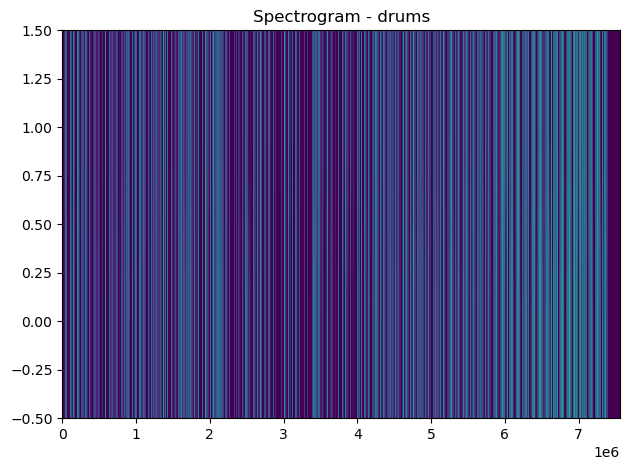

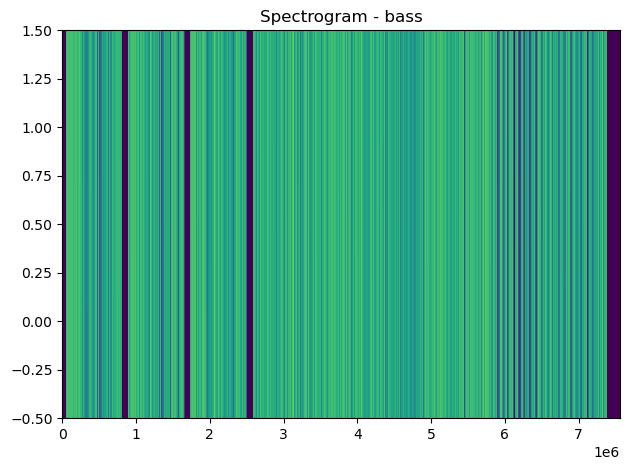

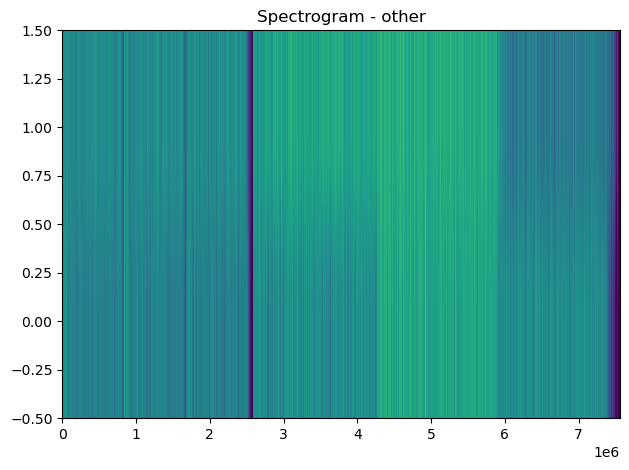

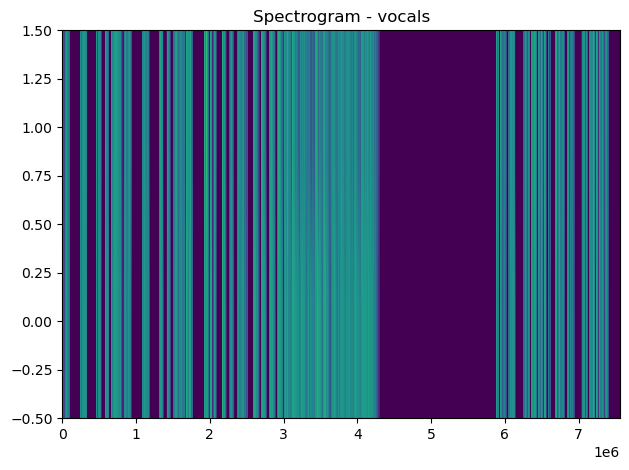

In [ ]:
from mir_eval.separation import bss_eval_sources

# Assuming you have paths to the original source files
original_source_paths = [
    "C:\\Users\\ritum\\OneDrive\\Desktop\\AudioFolder-Demucs\\vocals.wav",
    "C:\\Users\\ritum\\OneDrive\\Desktop\\AudioFolder-Demucs\\bass.wav",
    "C:\\Users\\ritum\\OneDrive\\Desktop\\AudioFolder-Demucs\\drums.wav",
    "C:\\Users\\ritum\\OneDrive\\Desktop\\AudioFolder-Demucs\\other.wav",
]

# Load the original sources
original_sources = [torchaudio.load(path)[0] for path in original_source_paths]



for i, (source_name, source_waveform) in enumerate(audios.items()):
    source_waveform_np = source_waveform.cpu().numpy()
    original_source_np = original_sources[i].numpy()

    # Calculate SDR
    sdr, _, _, _ = bss_eval_sources(original_source_np, source_waveform_np)
    print(f"SDR for {source_name}: {sdr.mean()}")

    # Plot the spectrogram
    plot_spectrogram(torch.tensor(source_waveform_np), f"Spectrogram - {source_name}")

    # Save to file
    output_path = os.path.join(output_directory, f"{source_name}.wav")
    torchaudio.save(output_path, torch.tensor(source_waveform_np), sample_rate)
    print(f"Saved {source_name} to {output_path}")

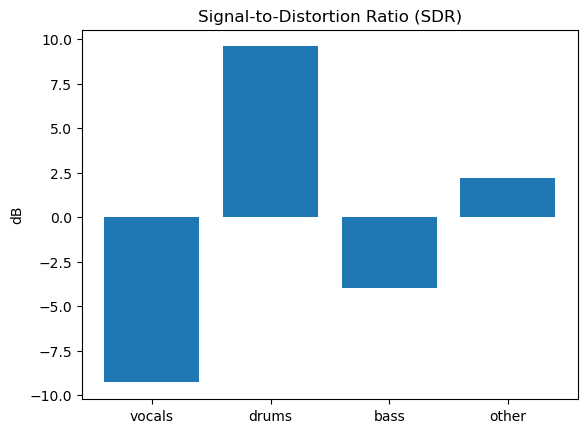

vocals: -9.29 dB
drums: 9.59 dB
bass: -4.01 dB
other: 2.22 dB


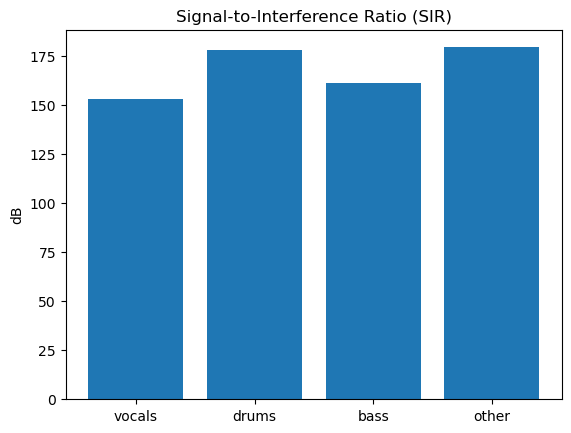

vocals: 153.40 dB
drums: 178.35 dB
bass: 161.17 dB
other: 179.60 dB


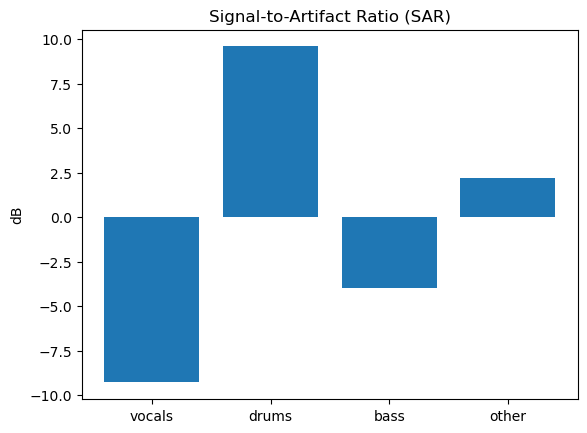

vocals: -9.29 dB
drums: 9.59 dB
bass: -4.01 dB
other: 2.22 dB


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import torchaudio
from mir_eval.separation import bss_eval_sources

# Function to plot a bar graph for a given metric
def plot_metric(metric_values, title):
    plt.bar(labels, metric_values)
    plt.ylabel('dB')
    plt.title(title)
    plt.show()
    for label, value in zip(labels, metric_values):
        print(f"{label}: {value:.2f} dB")


# Sample path to the original mixture (replace with the actual path)
#SAMPLE_SONG = "path_to_original_mixture.wav"

# Load the original and separated stems
original_stems = []
separated_stems = []

for target in ['vocals', 'drums', 'bass', 'other']: #,'residual']:
    # Assuming the original mixture is used for all stems (replace with actual original stems if available)
    original_waveform, _ = torchaudio.load(SAMPLE_SONG)

    # Replace with the correct paths to your separated stems
    separated_path = f"C:\\Users\\ritum\\OneDrive\\Desktop\\AudioFolder-Demucs\\{target}.wav"

    separated_waveform, _ = torchaudio.load(separated_path)

    # Convert to mono if stereo
    original_mono = original_waveform.mean(dim=0)
    separated_mono = separated_waveform.mean(dim=0)

    original_stems.append(original_mono.numpy())
    separated_stems.append(separated_mono.numpy())

# Stack the stems into arrays with shape (4, n_samples)
original_stems = np.stack(original_stems)
separated_stems = np.stack(separated_stems)

# Calculate SDR, SIR, and SAR
sdr, sir, sar, _ = bss_eval_sources(original_stems, separated_stems)

# Labels for the stems
labels = ['vocals', 'drums', 'bass', 'other']

# Plot SDR
plot_metric(sdr, 'Signal-to-Distortion Ratio (SDR)')

# Plot SIR
plot_metric(sir, 'Signal-to-Interference Ratio (SIR)')

# Plot SAR
plot_metric(sar, 'Signal-to-Artifact Ratio (SAR)')


In [ ]:
pip install numpy scipy matplotlib mir_eval

In [ ]:
pip install spleeter


In [ ]:
!spleeter separate -o "C:\\Users\\ritum\\OneDrive\\Desktop\\AudioFolder-Spleeter\\" SAMPLE_SONG

'spleeter' is not recognized as an internal or external command,
operable program or batch file.


In [ ]:


sdr_vocal_umx = -2.90
sdr_drums_umx = -3.00
sdr_bass_umx = 10.54
sdr_other_umx = 2.83

sdr_vocal_demucs = -9.29
sdr_drums_demucs = 9.59
sdr_bass_demucs = -4.01
sdr_other_demucs = 2.22

sdr_vocal_spleeter = -4.50
sdr_drums_spleeter = -5.33
sdr_bass_spleeter = 10.62
sdr_other_spleeter = 3.11

# Now you can continue with the normalization and weighting as previously defined


def normalize_sdr(*sdrs):
    shift_constant = abs(min(sdrs)) + 1
    shifted_sdrs = [sdr + shift_constant for sdr in sdrs]
    total_sdr = sum(shifted_sdrs)
    return [sdr / total_sdr for sdr in shifted_sdrs]

weights_vocal = normalize_sdr(sdr_vocal_umx, sdr_vocal_spleeter, sdr_vocal_demucs)
weights_drums = normalize_sdr(sdr_drums_umx, sdr_drums_spleeter, sdr_drums_demucs)
weights_bass = normalize_sdr(sdr_bass_umx, sdr_bass_spleeter, sdr_bass_demucs)
weights_other = normalize_sdr(sdr_other_umx, sdr_other_spleeter, sdr_other_demucs)


In [ ]:
from scipy.io import wavfile

vocals_openunmix_path = "C:\\Users\\ritum\\OneDrive\\Desktop\\AudioFolder-OpenUnmix\\open_unmix_source_vocals.wav"
drums_openunmix_path = "C:\\Users\\ritum\\OneDrive\\Desktop\\AudioFolder-OpenUnmix\\open_unmix_source_bass.wav"
bass_openunmix_path = "C:\\Users\\ritum\\OneDrive\\Desktop\\AudioFolder-OpenUnmix\\open_unmix_source_drums.wav"
other_openunmix_path = "C:\\Users\\ritum\\OneDrive\\Desktop\\AudioFolder-OpenUnmix\\open_unmix_source_other.wav"

# Read the audio files
_, vocals_openunmix = wavfile.read(vocals_openunmix_path)
_, drums_openunmix = wavfile.read(drums_openunmix_path)
_, bass_openunmix = wavfile.read(bass_openunmix_path)
_, other_openunmix = wavfile.read(other_openunmix_path)

# If the audio files are stereo, you might need to transpose them
vocals_openunmix = vocals_openunmix.T
drums_openunmix = drums_openunmix.T
bass_openunmix = bass_openunmix.T
other_openunmix = other_openunmix.T

# Continue with the merging code...


In [ ]:
from scipy.io import wavfile

vocals_demucs_path = "C:\\Users\\ritum\\OneDrive\\Desktop\\AudioFolder-Demucs\\vocals.wav"
drums_demucs_path = "C:\\Users\\ritum\\OneDrive\\Desktop\\AudioFolder-Demucs\\drums.wav"
bass_demucs_path = "C:\\Users\\ritum\\OneDrive\\Desktop\\AudioFolder-Demucs\\bass.wav"
other_demucs_path = "C:\\Users\\ritum\\OneDrive\\Desktop\\AudioFolder-Demucs\\other.wav"

# Read the audio files
_, vocals_demucs = wavfile.read(vocals_demucs_path)
_, drums_demucs = wavfile.read(drums_demucs_path)
_, bass_demucs = wavfile.read(bass_demucs_path)
_, other_demucs = wavfile.read(other_demucs_path)

# If the audio files are stereo, you might need to transpose them
vocals_demucs = vocals_demucs.T
drums_demucs = drums_demucs.T
bass_demucs = bass_demucs.T
other_demucs = other_demucs.T

# Continue with the merging code...


C:\Users\ritum\AppData\Local\Temp\ipykernel_6928\22172136.py:9: WavFileWarning: Chunk (non-data) not understood, skipping it.
  _, vocals_demucs = wavfile.read(vocals_demucs_path)
C:\Users\ritum\AppData\Local\Temp\ipykernel_6928\22172136.py:10: WavFileWarning: Chunk (non-data) not understood, skipping it.
  _, drums_demucs = wavfile.read(drums_demucs_path)
C:\Users\ritum\AppData\Local\Temp\ipykernel_6928\22172136.py:11: WavFileWarning: Chunk (non-data) not understood, skipping it.
  _, bass_demucs = wavfile.read(bass_demucs_path)
C:\Users\ritum\AppData\Local\Temp\ipykernel_6928\22172136.py:12: WavFileWarning: Chunk (non-data) not understood, skipping it.
  _, other_demucs = wavfile.read(other_demucs_path)


In [ ]:
from scipy.io import wavfile

vocals_spleeter_path = "C:\\Users\\ritum\\OneDrive\\Desktop\\AudioFolder-Spleeter\\vocals.wav"
drums_spleeter_path = "C:\\Users\\ritum\\OneDrive\\Desktop\\AudioFolder-Spleeter\\drums.wav"
bass_spleeter_path = "C:\\Users\\ritum\\OneDrive\\Desktop\\AudioFolder-Spleeter\\bass.wav"
other_spleeter_path = "C:\\Users\\ritum\\OneDrive\\Desktop\\AudioFolder-Spleeter\\other.wav"

# Read the audio files
_, vocals_spleeter = wavfile.read(vocals_spleeter_path)
_, drums_spleeter = wavfile.read(drums_spleeter_path)
_, bass_spleeter = wavfile.read(bass_spleeter_path)
_, other_spleeter = wavfile.read(other_spleeter_path)

# If the audio files are stereo, you might need to transpose them
vocals_spleeter = vocals_spleeter.T
drums_spleeter = drums_spleeter.T
bass_spleeter = bass_spleeter.T
other_spleeter = other_spleeter.T

# Continue with the merging code...


In [ ]:
merged_vocals = (
    weights_vocal[0] * vocals_openunmix +
    weights_vocal[1] * vocals_spleeter +
    weights_vocal[2] * vocals_demucs
)

merged_drums = (
    weights_drums[0] * drums_openunmix +
    weights_drums[1] * drums_spleeter +
    weights_drums[2] * drums_demucs
)

merged_bass = (
    weights_bass[0] * bass_openunmix +
    weights_bass[1] * bass_spleeter +
    weights_bass[2] * bass_demucs
)

merged_other = (
    weights_other[0] * other_openunmix +
    weights_other[1] * other_spleeter +
    weights_other[2] * other_demucs
)


In [ ]:
from IPython.display import Audio

# Play merged vocals
Audio(data=merged_vocals_int16, rate=sample_rate)




In [ ]:
Audio(data=merged_drums_int16, rate=sample_rate)


In [ ]:
Audio(data=merged_bass_int16, rate=sample_rate)

In [ ]:

Audio(data=merged_other_int16, rate=sample_rate)

In [ ]:
from scipy.io import wavfile

# Convert the merged vocals to int16 format
merged_vocals_int16 = (merged_vocals / np.max(np.abs(merged_vocals)) * 32767).astype(np.int16)

# Write the merged vocals to a file
output_path = 'C:\\Users\\ritum\\OneDrive\\Desktop\\Merged\\mergedvocals.wav'
wavfile.write(output_path, sample_rate, merged_vocals_int16)


In [ ]:
from mir_eval.separation import bss_eval_sources

def calculate_sdr(reference_sources, estimated_sources):
    sdr, _, _, _ = bss_eval_sources(reference_sources, estimated_sources)
    return sdr


C:\Users\ritum\AppData\Local\Temp\ipykernel_6928\2925726630.py:6: UserWarning: Only one segment is calculated since parameter NFFT (=2048) >= signal length (=2).
  S, freqs, times, _ = plt.specgram(audio, NFFT=2048, Fs=sample_rate, noverlap=1024)


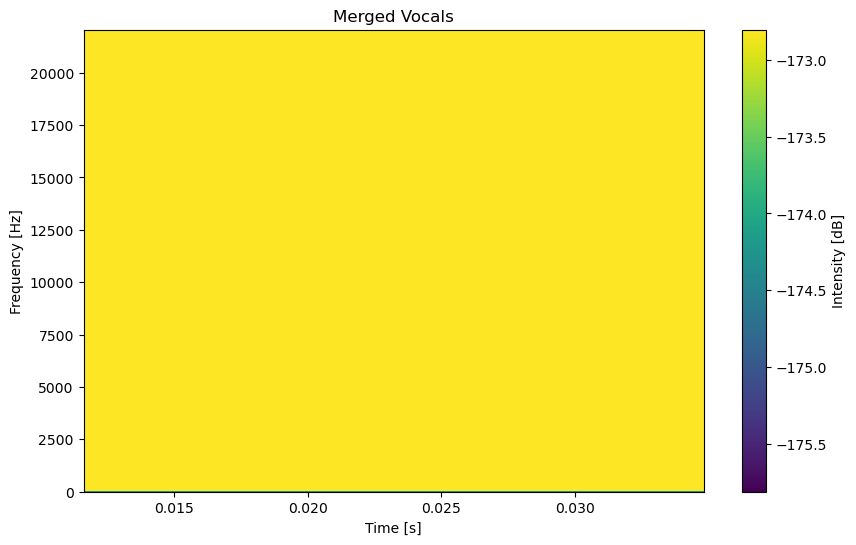

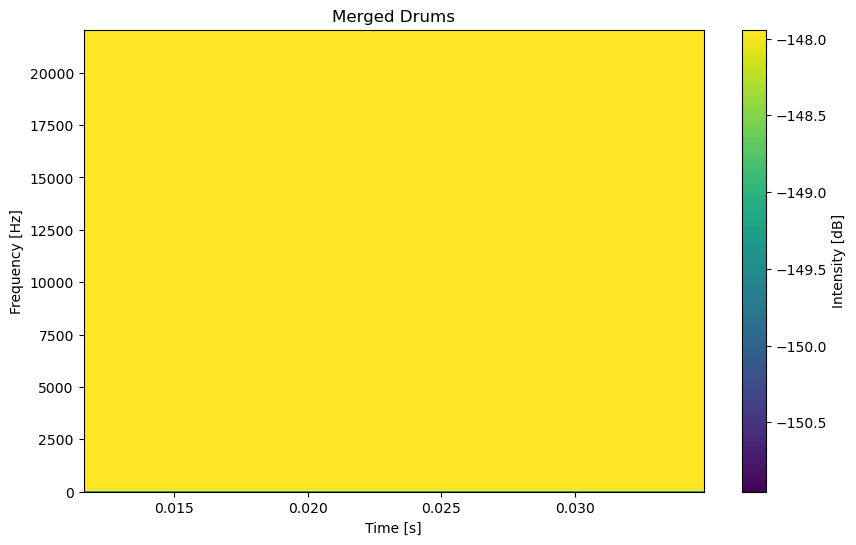

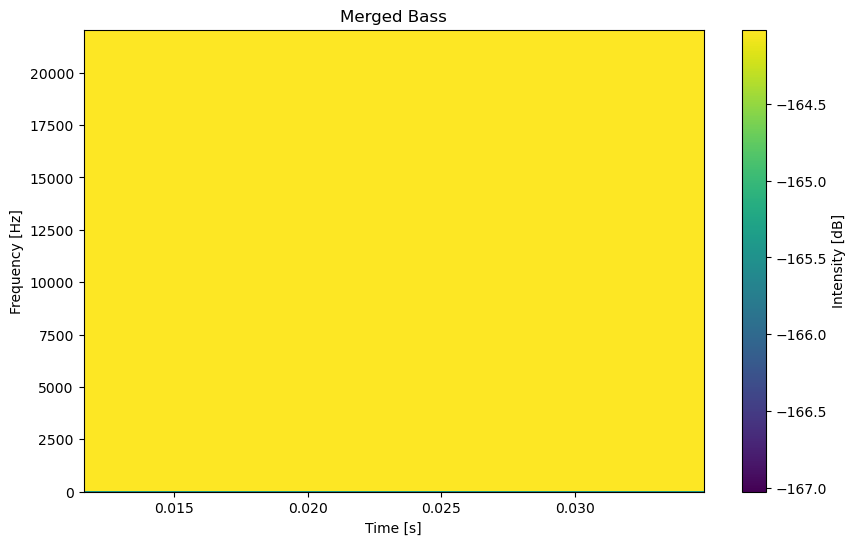

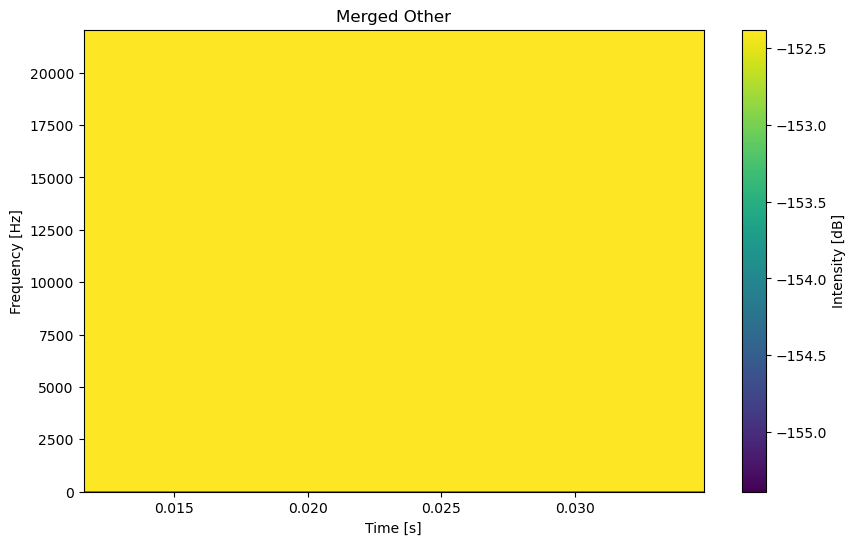

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

def plot_spectrogram(audio, sample_rate, title):
    plt.figure(figsize=(10, 6))
    S, freqs, times, _ = plt.specgram(audio, NFFT=2048, Fs=sample_rate, noverlap=1024)
    plt.ylabel('Frequency [Hz]')
    plt.xlabel('Time [s]')
    plt.title(title)
    plt.colorbar(label='Intensity [dB]')
    plt.show()

# Plot spectrograms for merged vocals, drums, bass, and other
plot_spectrogram(merged_vocals_int16, sample_rate, 'Merged Vocals')
plot_spectrogram(merged_drums_int16, sample_rate, 'Merged Drums')
plot_spectrogram(merged_bass_int16, sample_rate, 'Merged Bass')
plot_spectrogram(merged_other_int16, sample_rate, 'Merged Other')


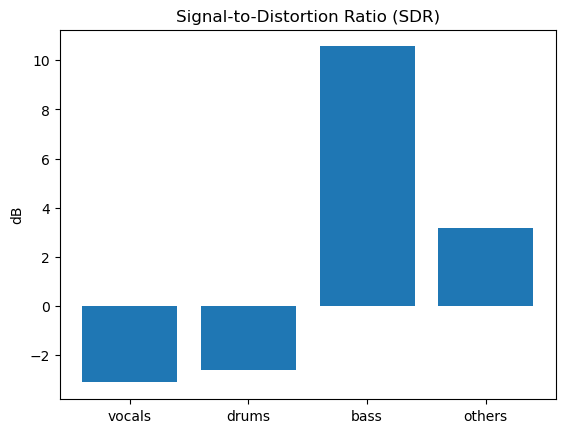

vocals: -3.12 dB
drums: -2.61 dB
bass: 10.56 dB
others: 3.16 dB


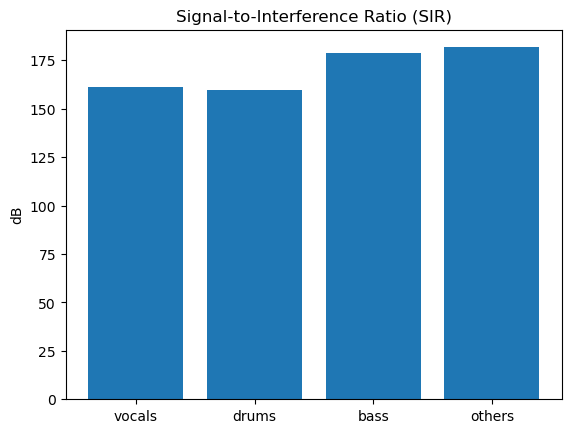

vocals: 161.27 dB
drums: 159.72 dB
bass: 178.88 dB
others: 181.68 dB


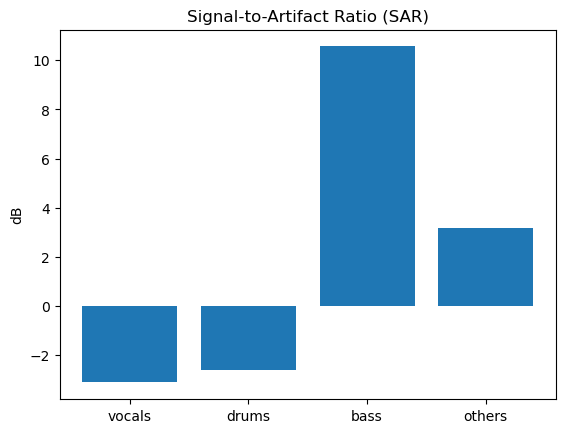

vocals: -3.12 dB
drums: -2.61 dB
bass: 10.56 dB
others: 3.16 dB


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import torchaudio
from mir_eval.separation import bss_eval_sources

# Function to plot a bar graph for a given metric
def plot_metric(metric_values, title):
    plt.bar(labels, metric_values)
    plt.ylabel('dB')
    plt.title(title)
    plt.show()
    for label, value in zip(labels, metric_values):
        print(f"{label}: {value:.2f} dB")


# Sample path to the original mixture (replace with the actual path)
#SAMPLE_SONG = "path_to_original_mixture.wav"

# Load the original and separated stems
original_stems = []
separated_stems = []

for target in ['vocals', 'drums', 'bass', 'others']: #,'residual']:
    # Assuming the original mixture is used for all stems (replace with actual original stems if available)
    original_waveform, _ = torchaudio.load(SAMPLE_SONG)

    # Replace with the correct paths to your separated stems
    separated_path = f"C:\\Users\\ritum\\OneDrive\\Desktop\\Merged\\merged_{target}.wav"

    separated_waveform, _ = torchaudio.load(separated_path)

    # Convert to mono if stereo
    original_mono = original_waveform.mean(dim=0)
    separated_mono = separated_waveform.mean(dim=0)

    original_stems.append(original_mono.numpy())
    separated_stems.append(separated_mono.numpy())

# Stack the stems into arrays with shape (4, n_samples)
original_stems = np.stack(original_stems)
separated_stems = np.stack(separated_stems)

# Calculate SDR, SIR, and SAR
sdr, sir, sar, _ = bss_eval_sources(original_stems, separated_stems)

# Labels for the stems
labels = ['vocals', 'drums', 'bass', 'others']

# Plot SDR
plot_metric(sdr, 'Signal-to-Distortion Ratio (SDR)')

# Plot SIR
plot_metric(sir, 'Signal-to-Interference Ratio (SIR)')

# Plot SAR
plot_metric(sar, 'Signal-to-Artifact Ratio (SAR)')


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import stft
from mir_eval.separation import bss_eval_sources
import soundfile as sf

def calculate_sdr(reference_sources, estimated_sources):
    sdr, _, _, _ = bss_eval_sources(reference_sources, estimated_sources)
    return sdr

# Ensure the shapes align (if they don't already)
original_vocals = original_vocals.reshape(-1, 1)
separated_vocals = separated_vocals[:, 0].reshape(-1, 1)  # Taking only one channel if stereo


def plot_spectrogram(signal, title):
    _, _, Zxx = stft(signal, nperseg=256)
    plt.pcolormesh(np.abs(Zxx))
    plt.title(title)
    plt.ylabel('Frequency [Hz]')
    plt.xlabel('Time [sec]')
    plt.colorbar(label='Intensity')
    plt.show()

# Load the original and separated sources
original_vocals, _ = sf.read('/content/sample_data/signal3.wav')
separated_vocals, _ = sf.read('/content/gdrive/MyDrive/AudioFolder2/signal3/bass.wav')

# Calculate the SDR
sdr_vocals = calculate_sdr(original_vocals, separated_vocals)
print(f'SDR for vocals: {sdr_vocals}')

# Plot the spectrogram
plot_spectrogram(separated_vocals, 'Spectrogram - Separated Vocals')


In [ ]:
total_sdr = sdr_openunmix + sdr_spleeter + sdr_demucs
weights_openunmix = sdr_openunmix / total_sdr
weights_spleeter = sdr_spleeter / total_sdr
weights_demucs = sdr_demucs / total_sdr


In [ ]:
import numpy as np
import soundfile as sf

# Read the three bass files
bass1, samplerate = sf.read(str('/content/gdrive/MyDrive/AudioFolder/open_unmix_source_bass.wav'))
bass2, _ = sf.read('/content/gdrive/MyDrive/AudioFolder1/bass.wav')
bass3, _ = sf.read('/content/gdrive/MyDrive/AudioFolder2/signal3/bass.wav')

# Concatenate the three files
merged_bass = np.concatenate((bass1, bass2, bass3), axis=0)

# Write the result to a new file
sf.write('/content/gdrive/MyDrive/AudioFolderFinal/merged_bass.wav', merged_bass, samplerate)


In [ ]:
import torchaudio
import numpy as np
from mir_eval.separation import bss_eval_sources
import matplotlib.pyplot as plt

# Load the original and separated bass audio files
original_bass, _ = torchaudio.load('/content/gdrive/MyDrive/AudioFolder/open_unmix_source_bass.wav')
separated_bass, _ = torchaudio.load('/content/gdrive/MyDrive/AudioFolderFinal/merged_bass.wav')

# Ensure that the separated bass audio has the same length as the original
separated_bass = separated_bass[:, :original_bass.shape[1]]

# Convert torch tensors to numpy arrays
original_bass_np = original_bass.numpy()
separated_bass_np = separated_bass.numpy()

# Calculate SDR
sdr, _, _, _ = bss_eval_sources(original_bass_np, separated_bass_np)
print(f'SDR for bass: {sdr}')

# Generate and display spectrogram
plt.figure(figsize=(10, 6))

plt.subplot(2, 1, 1)
plt.specgram(original_bass_np, Fs=original_bass.shape[0], NFFT=1024, noverlap=512)
plt.title('Original Bass Spectrogram')
plt.xlabel('Time')
plt.ylabel('Frequency')

plt.subplot(2, 1, 2)
plt.specgram(separated_bass_np, Fs=separated_bass.shape[0], NFFT=1024, noverlap=512)
plt.title('Separated Bass Spectrogram')
plt.xlabel('Time')
plt.ylabel('Frequency')

plt.tight_layout()
plt.show()


In [ ]:
pip install noisereduce


Note: you may need to restart the kernel to use updated packages.Collecting noisereduce



In [ ]:
for target in targets:
    # Load separated stem
    separated_path = f"C:\\Users\\ritum\\OneDrive\\Desktop\\Merged\\merged_{target}.wav"
    separated_stem, _ = torchaudio.load(separated_path)
    separated_stem_np = separated_stem.numpy().squeeze()

    # Apply equalization
    equalized_stem = apply_equalization(separated_stem_np.T, lowcut=100, highcut=1000, fs=sample_rate)
    equalized_stem = equalized_stem.T  # Transpose back

    # Convert to int16
    equalized_stem_int16 = (equalized_stem / np.max(np.abs(equalized_stem)) * 32767).astype(np.int16)

    # Write to a file
    output_path = f'C:\\Users\\ritum\\OneDrive\\Desktop\\Merged\\equalized_{target}.wav'
    wavfile.write(output_path, sample_rate, equalized_stem_int16.T) # Transpose if needed

    print(f'Equalized stem for {target} written to {output_path}')

In [ ]:
import torchaudio
from mir_eval.separation import bss_eval_sources
from scipy.signal import butter, lfilter
import numpy as np

# Apply equalization
def apply_equalization(data, lowcut, highcut, fs):
    nyquist = 0.5 * fs
    low = lowcut / nyquist
    high = highcut / nyquist
    b, a = butter(1, [low, high], btype='band')
    return lfilter(b, a, data)

# Calculate SDR
def calculate_sdr(reference_sources, estimated_sources):
    sdr, _, _, _ = bss_eval_sources(reference_sources, estimated_sources)
    return sdr

# Path to original song
original_waveform, sample_rate = torchaudio.load(SAMPLE_SONG)
original_waveform_np = original_waveform.numpy().squeeze()

# Process each target
targets = ["vocals", "drums", "bass", "others"]
for target in targets:
    # Load separated stem
    separated_path = f"C:\\Users\\ritum\\OneDrive\\Desktop\\Merged\\merged_{target}.wav"
    separated_stem, _ = torchaudio.load(separated_path)
    separated_stem_np = separated_stem.numpy().squeeze()

    # Apply equalization
    equalized_stem = apply_equalization(separated_stem_np.T, lowcut=100, highcut=1000, fs=sample_rate)
    equalized_stem = equalized_stem.T  # Transpose back

    # Print shapes for debugging
    print(f"Original shape: {original_waveform_np.shape}")
    print(f"Separated shape: {separated_stem_np.shape}")
    print(f"Equalized shape: {equalized_stem.shape}")

    # Calculate SDR for the equalized stem
    sdr_values = calculate_sdr(original_waveform_np, equalized_stem)
    for i, sdr in enumerate(sdr_values):
        print(f'SDR for {target} channel {i}: {sdr:.2f} dB')

    # Convert to int16
    equalized_stem_int16 = (equalized_stem / np.max(np.abs(equalized_stem)) * 32767).astype(np.int16)

    # Write to a file
    output_path = f'C:\\Users\\ritum\\OneDrive\\Desktop\\Merged\\equalized_{target}.wav'
    wavfile.write(output_path, sample_rate, equalized_stem_int16.T) # Transpose if needed

    print(f'Equalized stem for {target} written to {output_path}')


Original shape: (2, 7560512)
Separated shape: (2, 7560512)
Equalized shape: (2, 7560512)
SDR for vocals channel 0: -2.17 dB
SDR for vocals channel 1: -6.92 dB
Equalized stem for vocals written to C:\Users\ritum\OneDrive\Desktop\Merged\equalized_vocals.wav
Original shape: (2, 7560512)
Separated shape: (2, 7560512)
Equalized shape: (2, 7560512)
SDR for drums channel 0: 9.99 dB
SDR for drums channel 1: 9.47 dB
Equalized stem for drums written to C:\Users\ritum\OneDrive\Desktop\Merged\equalized_drums.wav
Original shape: (2, 7560512)
Separated shape: (2, 7560512)
Equalized shape: (2, 7560512)
SDR for bass channel 0: -2.57 dB
SDR for bass channel 1: -4.08 dB
Equalized stem for bass written to C:\Users\ritum\OneDrive\Desktop\Merged\equalized_bass.wav
Original shape: (2, 7560512)
Separated shape: (2, 7560512)
Equalized shape: (2, 7560512)
SDR for others channel 0: 3.37 dB
SDR for others channel 1: -1.28 dB
Equalized stem for others written to C:\Users\ritum\OneDrive\Desktop\Merged\equalized_ot

In [ ]:
 display(Audio(SAMPLE_SONG, rate=sample_rate))

In [ ]:
import torchaudio
from mir_eval.separation import bss_eval_sources
from scipy.signal import butter, lfilter
from scipy.io import wavfile
import numpy as np
import soundfile as sf

def equalize_audio(data, lowcut, highcut, fs):
    """Applies a bandpass Butterworth filter to the audio data."""
    nyquist = 0.5 * fs
    low = lowcut / nyquist
    high = highcut / nyquist
    b, a = butter(1, [low, high], btype='band')
    return lfilter(b, a, data)

def compute_sdr(reference, estimated):
    """Computes Signal-to-Distortion Ratio."""
    # Ensure data is 2D
    if len(reference.shape) == 1:
        reference = reference[np.newaxis, :]
    if len(estimated.shape) == 1:
        estimated = estimated[np.newaxis, :]

    # Check if any channel in reference or estimated is silent
    non_silent_channels = [i for i in range(reference.shape[0]) if np.any(reference[i]) and np.any(estimated[i])]

    # If all channels are silent, return a list of -inf for SDR
    if not non_silent_channels:
        return [-np.inf] * reference.shape[0]

    # If some channels are non-silent, compute SDR only for them
    sdr, _, _, _ = bss_eval_sources(reference[non_silent_channels], estimated[non_silent_channels])

    # Prepare the final SDR list
    sdr_full = [-np.inf] * reference.shape[0]
    for i, value in zip(non_silent_channels, sdr):
        sdr_full[i] = value

    return sdr_full



def process_audio_target(target, original_audio, sample_rate):
    """Processes a specific audio target."""
    # Load separated audio
    separated_audio, _ = sf.read(f"C:\\Users\\ritum\\OneDrive\\Desktop\\Merged\\merged_{target}.wav")
    separated_audio_np = separated_audio.squeeze()

    # Check for silent audio or very low energy
    if np.mean(np.abs(separated_audio_np)) < 1e-5 or np.mean(np.abs(original_audio)) < 1e-5:
        print(f"Skipping {target} due to silent or very low energy audio.")
        return

    # Apply equalization
    equalized_audio = equalize_audio(separated_audio_np.T, lowcut=100, highcut=1000, fs=sample_rate).T

    # Ensure the audio is 2D for bss_eval_sources
    if len(original_audio.shape) == 1:
        original_audio = original_audio[np.newaxis, :]
    if len(equalized_audio.shape) == 1:
        equalized_audio = equalized_audio[np.newaxis, :]

    # Check if either audio is silent before computing SDR
   # if np.any(original_audio) and np.any(equalized_audio):
        # Calculate SDR
        #""sdr_values = compute_sdr(original_audio, equalized_audio)
       # for i, sdr in enumerate(sdr_values):
        #    print(f'SDR for {target} channel {i}: {sdr:.2f} dB')
    #else:
     #   print(f"Skipping SDR computation for {target} due to silent audio.")

    # Convert to int16 and save
    equalized_audio_int16 = (equalized_audio / np.max(np.abs(equalized_audio)) * 32767).astype(np.int16)
    output_path = f'C:\\Users\\ritum\\OneDrive\\Desktop\\Merged\\equalized_{target}.wav'
    wavfile.write(output_path, sample_rate, equalized_audio_int16.T)

    print(f'Processed audio for {target} saved to {output_path}')

if __name__ == "__main__":
    # Load original song
    original_waveform, sample_rate = sf.read(f"C:\\Users\\ritum\\OneDrive\\Desktop\\Merged\\orignal.wav")
    original_waveform_np = original_waveform.squeeze()

    # Define targets and process each
    audio_targets = ["vocals", "drums", "bass", "others"]
    for target in audio_targets:
        process_audio_target(target, original_waveform_np, sample_rate)


In [ ]:
import torchaudio
from mir_eval.separation import bss_eval_sources
from scipy.signal import butter, lfilter
import numpy as np

# Apply equalization
def apply_equalization(data, lowcut, highcut, fs):
    nyquist = 0.5 * fs
    low = lowcut / nyquist
    high = highcut / nyquist
    b, a = butter(1, [low, high], btype='band')
    return lfilter(b, a, data)

# Calculate SDR
def calculate_sdr(reference_sources, estimated_sources):
    sdr, _, _, _ = bss_eval_sources(reference_sources, estimated_sources)
    return sdr

# Path to original song
original_waveform, sample_rate = torchaudio.load(SAMPLE_SONG)
original_waveform_np = original_waveform.numpy().squeeze()

# Process each target
targets = ["vocals", "drums", "bass", "others"]
for target in targets:
    # Load separated stem
    separated_path = f"C:\\Users\\ritum\\OneDrive\\Desktop\\Merged\\merged_{target}.wav"
    separated_stem, _ = torchaudio.load(separated_path)
    separated_stem_np = separated_stem.numpy().squeeze()

    # Apply equalization
    equalized_stem = apply_equalization(separated_stem_np.T, lowcut=100, highcut=1000, fs=sample_rate)
    equalized_stem = equalized_stem.T  # Transpose back

    # Print shapes for debugging
    print(f"Original shape: {original_waveform_np.shape}")
    print(f"Separated shape: {separated_stem_np.shape}")
    print(f"Equalized shape: {equalized_stem.shape}")

    # Calculate SDR for the equalized stem
    sdr_values = calculate_sdr(original_waveform_np, equalized_stem)
    for i, sdr in enumerate(sdr_values):
        print(f'SDR for {target} channel {i}: {sdr:.2f} dB')

    # Convert to int16
    equalized_stem_int16 = (equalized_stem / np.max(np.abs(equalized_stem)) * 32767).astype(np.int16)

    # Write to a file
    output_path = f'C:\\Users\\ritum\\OneDrive\\Desktop\\Merged\\equalized_{target}.wav'
    wavfile.write(output_path, sample_rate, equalized_stem_int16.T) # Transpose if needed


